# Pycaret clustering harinas

---

[Conexión con base de datos](##Conexión-con-base-de-datos)

[Limpieza de datos](#Limpieza-de-datos)

[Metadata](#Metadata)

[Árbol de decisión](#Árbol-de-decisión)

## Conexión con base de datos
---
Realiza la conexión con base de datos local que contiene datos históricos

In [1]:
import pandas as pd
pd.set_option('display.max_columns', None)

In [2]:
df = pd.read_csv('./data/base.csv')

C:\Users\lacia\AppData\Local\Temp\ipykernel_14160\1628910066.py:1: DtypeWarning: Columns (5,7,8,9,12,14,15,16,17,18) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('./data/base.csv')


In [3]:
df.head()

,Unnamed: 0,key,bandera_id,lat,lng,sucursalnombre,id_,sucursaltipo,provincia,promo1_descripcion,promo1_precio,preciolista,promo2_descripcion,promo2_precio,actualizadohoy,direccion,banderadescripcion,localidad,comerciorazonsocial,comercioid,marca,nombre,presentacion,fecha
0,0,sucursales,1,-34.603651,-58.405234,384 - BALVANERA,7790070012050,Autoservicio,AR-C,0% de descuento. Precio Promocional Exclusivo ...,186.37,186.37,NaN,NaN,True,Av Pueyrredon 576 (Balvanera),Supermercados DIA,CAPITAL FEDERAL,DIA Argentina S.A,15,COCINERO,Aceite de Girasol Cocinero 900 Ml,900.0 ml,2022-08-24
1,1,sucursales,1,-34.676463,-58.493397,386 - VILLA LUGANO,7790070012050,Autoservicio,AR-C,0% de descuento. Precio Promocional Exclusivo ...,186.37,186.37,NaN,NaN,True,Montiel 3829 (Villa Lugano),Supermercados DIA,CAPITAL FEDERAL,DIA Argentina S.A,15,COCINERO,Aceite de Girasol Cocinero 900 Ml,900.0 ml,2022-08-24
2,2,sucursales,1,-34.653074,-58.481413,387 - PARQUE AVELLANEDA,7790070012050,Autoservicio,AR-C,0% de descuento. Precio Promocional Exclusivo ...,186.37,186.37,NaN,NaN,True,Av Olivera 1268 (Villa Lugano),Supermercados DIA,CAPITAL FEDERAL,DIA Argentina S.A,15,COCINERO,Aceite de Girasol Cocinero 900 Ml,900.0 ml,2022-08-24
3,3,sucursales,1,-34.626284,-58.456988,389 - FLORES,7790070012050,Autoservicio,AR-C,0% de descuento. Precio Promocional Exclusivo ...,186.37,186.37,NaN,NaN,True,Av Boyaca 37 (Flores),Supermercados DIA,CAPITAL FEDERAL,DIA Argentina S.A,15,COCINERO,Aceite de Girasol Cocinero 900 Ml,900.0 ml,2022-08-24
4,4,sucursales,1,-35.053089,-58.760641,39 - CAÑUELAS,7790070012050,Autoservicio,AR-B,0% de descuento. Precio Promocional Exclusivo ...,186.37,186.37,NaN,NaN,True,Cl Rivadavia 800,Supermercados DIA,BUENOS AIRES,DIA Argentina S.A,15,COCINERO,Aceite de Girasol Cocinero 900 Ml,900.0 ml,2022-08-24


In [4]:
df.shape

(1153800, 24)

In [5]:
print(df.fecha.max())
print(df.fecha.min())

2022-08-25
2022-06-11


In [6]:
df.dtypes

Unnamed: 0               int64
key                     object
bandera_id               int64
lat                    float64
lng                    float64
sucursalnombre          object
id_                      int64
sucursaltipo            object
provincia               object
promo1_descripcion      object
promo1_precio          float64
preciolista            float64
promo2_descripcion      object
promo2_precio          float64
actualizadohoy          object
direccion               object
banderadescripcion      object
localidad               object
comerciorazonsocial     object
comercioid               int64
marca                   object
nombre                  object
presentacion            object
fecha                   object
dtype: object

In [7]:
df['fecha'] = pd.to_datetime(df['fecha'], format='%Y-%m-%d')

In [8]:
#Filtro universo harinas
marcas_harina = ['CASERITA','MORIXE','FAVORITA']
df_harina = df.loc[df['marca'].isin(marcas_harina)]
df_harina.head()

,Unnamed: 0,key,bandera_id,lat,lng,sucursalnombre,id_,sucursaltipo,provincia,promo1_descripcion,promo1_precio,preciolista,promo2_descripcion,promo2_precio,actualizadohoy,direccion,banderadescripcion,localidad,comerciorazonsocial,comercioid,marca,nombre,presentacion,fecha
79,79,sucursales,1,NaN,NaN,NaN,7790070507242,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-22
80,80,sucursales,1,NaN,NaN,NaN,7790070507242,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-22
81,81,sucursales,1,NaN,NaN,NaN,7790070507242,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-22
82,82,sucursales,2,NaN,NaN,NaN,7790070507242,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-22
83,83,sucursales,1,NaN,NaN,NaN,7790070507242,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-22


In [9]:
#Filtro registros con datos
df_harina = df_harina[df_harina['preciolista']> 0]
df_harina.head()

,Unnamed: 0,key,bandera_id,lat,lng,sucursalnombre,id_,sucursaltipo,provincia,promo1_descripcion,promo1_precio,preciolista,promo2_descripcion,promo2_precio,actualizadohoy,direccion,banderadescripcion,localidad,comerciorazonsocial,comercioid,marca,nombre,presentacion,fecha
298,298,sucursales,5,-34.484169,-58.595829,San Fernando,7790070507242,Hipermercado,AR-B,"Llevando este producto, pagás $135.99 hasta e...",135.99,160.00,NaN,NaN,True,Cno Bancalari E/202 Y Uruguay,Walmart SuperCenter,SAN FERNANDO,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24
299,299,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790070507242,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",135.99,166.00,NaN,NaN,True,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24
300,300,sucursales,5,-32.850687,-68.858646,Las Heras,7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $145.00 hasta e...",144.99,145.06,NaN,NaN,True,Boulogne Sur Mer Y Regalado Olguin,Walmart SuperCenter,MENDOZA CIUDAD,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24
301,301,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",135.99,145.06,NaN,NaN,True,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24
599,599,sucursales,2,-34.913497,-57.951821,La Plata I,7792590000227,Supermercado,AR-B,NaN,NaN,163.50,NaN,NaN,True,Calle 7 767,Market,La Plata,INC S.A.,10,CASERITA,Harina de Trigo 0000 Caserita 1 Kg,1.0 kg,2022-08-17


In [10]:
df_harina.shape

(213228, 24)

In [11]:
#Filtro registros con datos
df_harina_d = df_harina.loc[df_harina['fecha'] >= '2022-8-24']
df_harina_d.head()

,Unnamed: 0,key,bandera_id,lat,lng,sucursalnombre,id_,sucursaltipo,provincia,promo1_descripcion,promo1_precio,preciolista,promo2_descripcion,promo2_precio,actualizadohoy,direccion,banderadescripcion,localidad,comerciorazonsocial,comercioid,marca,nombre,presentacion,fecha
298,298,sucursales,5,-34.484169,-58.595829,San Fernando,7790070507242,Hipermercado,AR-B,"Llevando este producto, pagás $135.99 hasta e...",135.99,160.00,NaN,NaN,True,Cno Bancalari E/202 Y Uruguay,Walmart SuperCenter,SAN FERNANDO,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24
299,299,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790070507242,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",135.99,166.00,NaN,NaN,True,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24
300,300,sucursales,5,-32.850687,-68.858646,Las Heras,7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $145.00 hasta e...",144.99,145.06,NaN,NaN,True,Boulogne Sur Mer Y Regalado Olguin,Walmart SuperCenter,MENDOZA CIUDAD,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24
301,301,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",135.99,145.06,NaN,NaN,True,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24
1061443,1061443,sucursales,1,-32.426197,-63.738309,1513 - HERNANDO,7792590000227,Autoservicio,AR-X,NaN,NaN,161.13,NaN,NaN,True,Bv Rivadavia 300,Supermercados DIA,CORDOBA,DIA Argentina S.A,15,CASERITA,Harina de Trigo 0000 Caserita 1 Kg,1.0 kg,2022-08-25


In [12]:
df_harina_d.shape

(7475, 24)

In [13]:
import pycaret.clustering as pc

In [14]:
from pycaret.clustering import *

In [22]:
df_harina_d.keys()

Index(['Unnamed: 0', 'key', 'bandera_id', 'lat', 'lng', 'sucursalnombre',
       'id_', 'sucursaltipo', 'provincia', 'promo1_descripcion',
       'promo1_precio', 'preciolista', 'promo2_descripcion', 'promo2_precio',
       'actualizadohoy', 'direccion', 'banderadescripcion', 'localidad',
       'comerciorazonsocial', 'comercioid', 'marca', 'nombre', 'presentacion',
       'fecha'],
      dtype='object')

In [40]:
features_i = []
features_i = ['Unnamed: 0', 'key', 'bandera_id', 'sucursalnombre',
       'id_', 'provincia', 'promo1_descripcion',
       'promo2_descripcion',
       'actualizadohoy', 'direccion', 'banderadescripcion', 'localidad',
       'comerciorazonsocial', 'comercioid', 'nombre', 'presentacion',
       'fecha']

In [41]:
clf1 = pc.setup(data = df_harina_d, use_gpu=True, ignore_features = features_i)

,Description,Value
0,session_id,6189
1,Original Data,"(7475, 24)"
2,Missing Values,True
3,Numeric Features,5
4,Categorical Features,2
5,Ordinal Features,False
6,High Cardinality Features,False
7,High Cardinality Method,None
8,Transformed Data,"(7475, 11)"
9,CPU Jobs,-1


In [37]:
pc.models()

,Name,Reference
ID,,
kmeans,K-Means Clustering,sklearn.cluster._kmeans.KMeans
ap,Affinity Propagation,sklearn.cluster._affinity_propagation.Affinity...
meanshift,Mean Shift Clustering,sklearn.cluster._mean_shift.MeanShift
sc,Spectral Clustering,sklearn.cluster._spectral.SpectralClustering
hclust,Agglomerative Clustering,sklearn.cluster._agglomerative.AgglomerativeCl...
dbscan,Density-Based Spatial Clustering,sklearn.cluster._dbscan.DBSCAN
optics,OPTICS Clustering,sklearn.cluster._optics.OPTICS
birch,Birch Clustering,sklearn.cluster._birch.Birch
kmodes,K-Modes Clustering,kmodes.kmodes.KModes


In [45]:
kmeans = pc.create_model('kmeans', num_clusters = 5)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.5412,7552.6163,0.7581,0,0,0


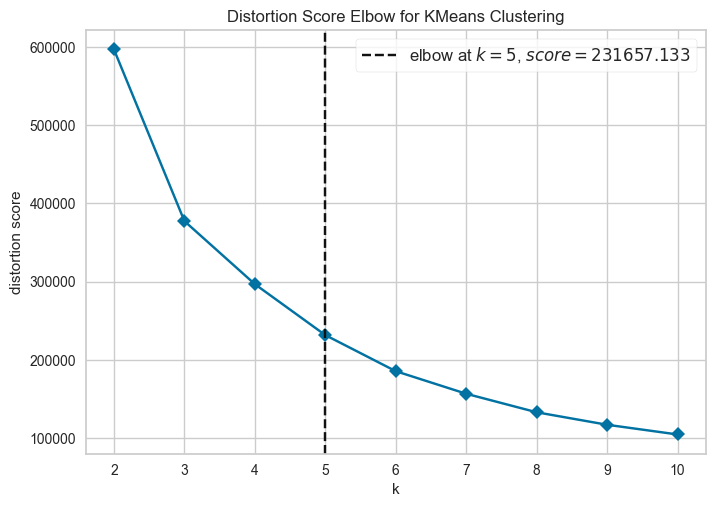

In [46]:
plot_model(kmeans, 'elbow')

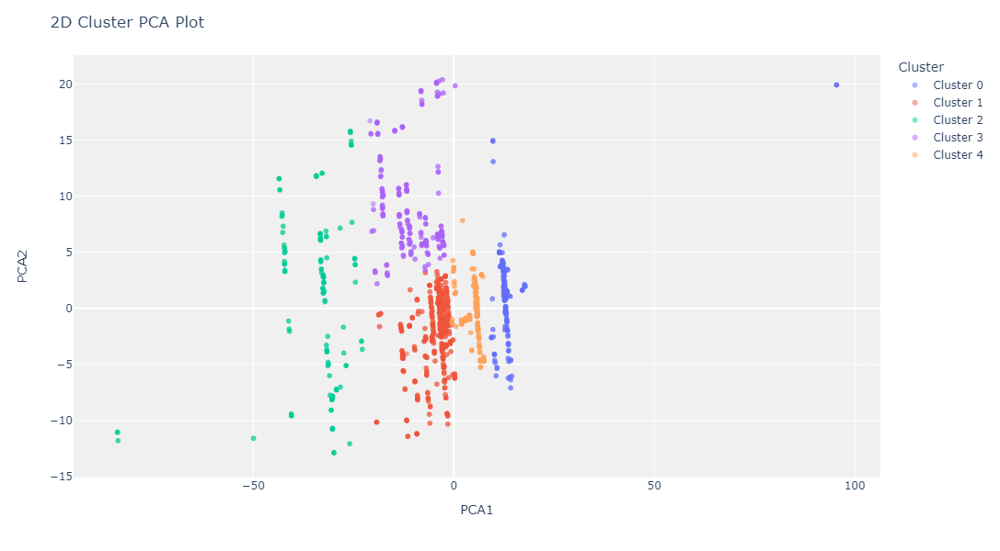

In [47]:
plot_model(kmeans, 'cluster')

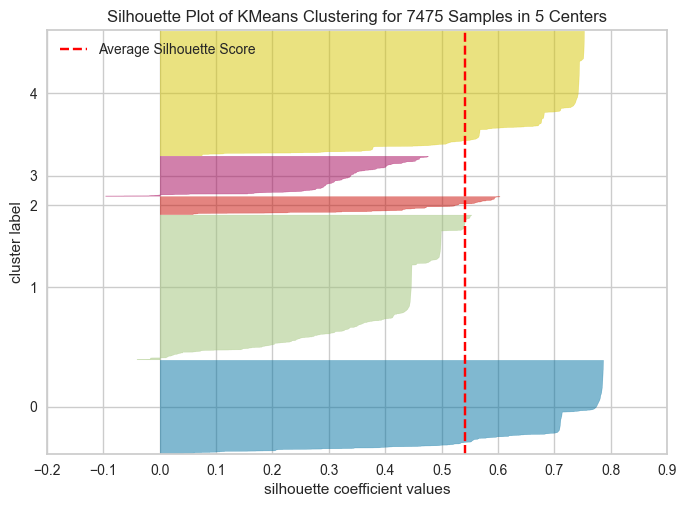

In [48]:
plot_model(kmeans, plot = 'silhouette')

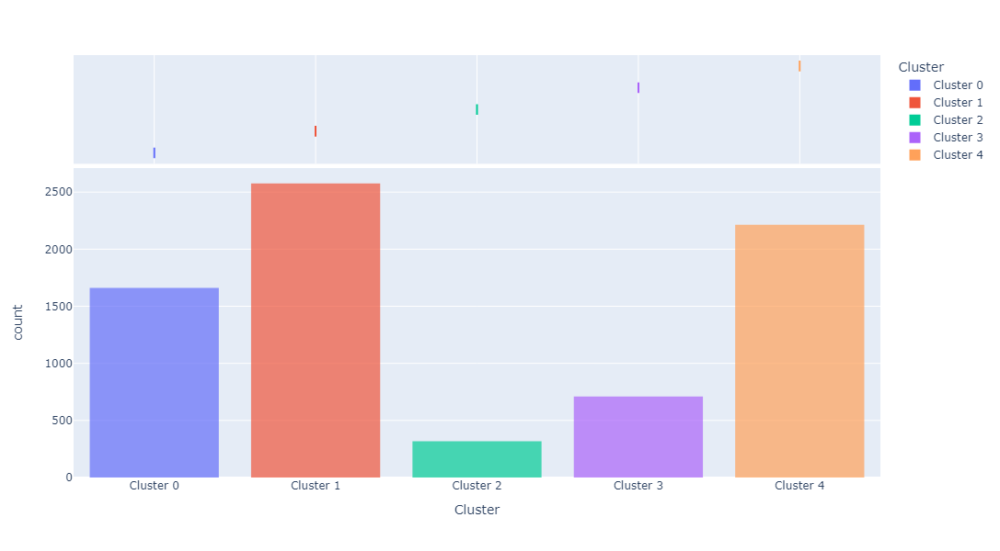

In [49]:
plot_model(kmeans, plot = 'distribution')

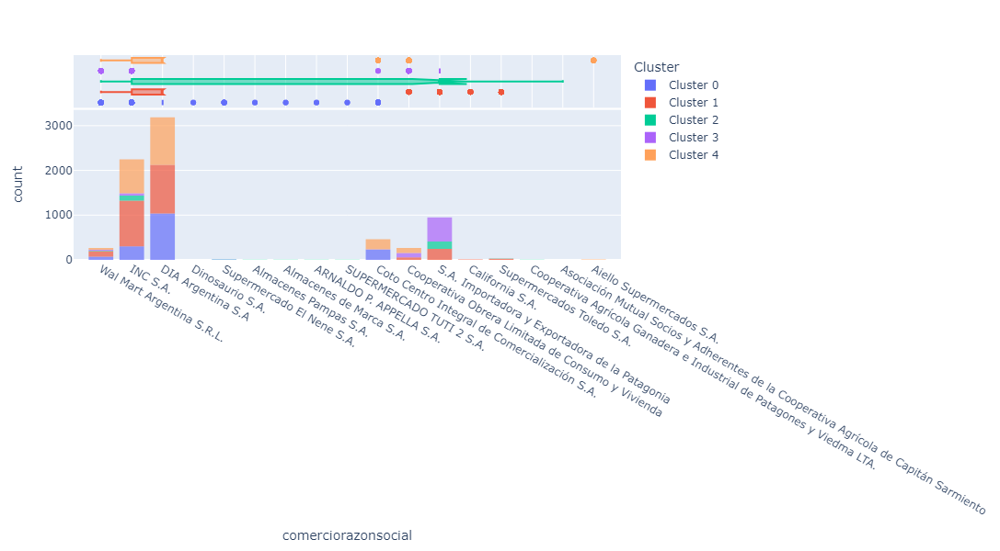

In [51]:
plot_model(kmeans, plot = 'distribution', feature = 'comerciorazonsocial')

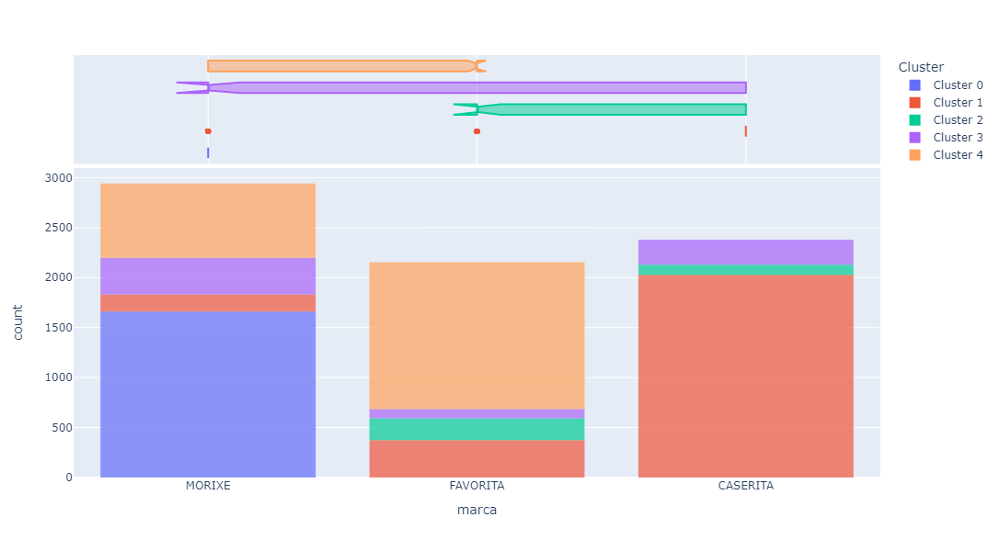

In [52]:
plot_model(kmeans, plot = 'distribution', feature = 'marca')

In [53]:
save_model(kmeans, 'clustering_model')
results = assign_model(kmeans)
results.head(10)

Transformation Pipeline and Model Successfully Saved


,Unnamed: 0,key,bandera_id,lat,lng,sucursalnombre,id_,sucursaltipo,provincia,promo1_descripcion,...,direccion,banderadescripcion,localidad,comerciorazonsocial,comercioid,marca,nombre,presentacion,fecha,Cluster
298,298,sucursales,5,-34.484169,-58.595829,San Fernando,7790070507242,Hipermercado,AR-B,"Llevando este producto, pagás $135.99 hasta e...",...,Cno Bancalari E/202 Y Uruguay,Walmart SuperCenter,SAN FERNANDO,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24,Cluster 1
299,299,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790070507242,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",...,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24,Cluster 1
300,300,sucursales,5,-32.850687,-68.858646,Las Heras,7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $145.00 hasta e...",...,Boulogne Sur Mer Y Regalado Olguin,Walmart SuperCenter,MENDOZA CIUDAD,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24,Cluster 0
301,301,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",...,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24,Cluster 0
1061443,1061443,sucursales,1,-32.426197,-63.738309,1513 - HERNANDO,7792590000227,Autoservicio,AR-X,NaN,...,Bv Rivadavia 300,Supermercados DIA,CORDOBA,DIA Argentina S.A,15,CASERITA,Harina de Trigo 0000 Caserita 1 Kg,1.0 kg,2022-08-25,Cluster 1
1061959,1061959,sucursales,1,-35.053089,-58.760641,39 - CAÑUELAS,7790070507242,Autoservicio,AR-B,NaN,...,Cl Rivadavia 800,Supermercados DIA,BUENOS AIRES,DIA Argentina S.A,15,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-25,Cluster 4
1061965,1061965,sucursales,2,-32.868658,-68.852646,Mendoza Sexta,7790070507242,Supermercado,AR-M,NaN,...,Jorge A. Calle 631,Market,Mendoza,INC S.A.,10,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-25,Cluster 1
1061970,1061970,sucursales,3,-34.851160,-58.077030,Av. Arana 231,7790199000020,Supermercado,AR-B,NaN,...,Av. Arana 231,Express,La Plata,INC S.A.,10,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-25,Cluster 4
1061973,1061973,sucursales,1,-34.665007,-58.362318,AVELLANEDA,7790199000020,Supermercado,AR-B,NaN,...,Italia 62,COTO CICSA,Avellaneda,Coto Centro Integral de Comercialización S.A.,12,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-25,Cluster 0
1061974,1061974,sucursales,1,-34.743716,-58.289187,QUILMES,7790199000020,Supermercado,AR-B,NaN,...,12 De Octubre 3054,COTO CICSA,Quilmes,Coto Centro Integral de Comercialización S.A.,12,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-25,Cluster 0


In [54]:
#Exportación modelo
results.to_csv('./data/Kmeans_Harina_25-8.csv')

## Limpieza de datos
---
Revisa tipo de datos obtenido y los convertimos de corresponder

In [ ]:
df.describe()

In [ ]:
df.dtypes

In [ ]:
df['promo1_precio'].isnull()

In [ ]:
df['lat'] = df['lat'].astype('float64')
df['lng'] = df['lng'].astype('float64')
df['fecha'] = pd.to_datetime(df['fecha'])


In [ ]:
df.describe()

In [ ]:
print(df['fecha'].min())
print(df['fecha'].max())

## Metadata
---
Obtiene datos dólar blue a fin de realizar correlaciones

Fuente https://www.ambito.com/contenidos/dolar-informal-historico.html 11/09/2022 14:25hs

In [ ]:
import datetime
import matplotlib.pyplot as plt

In [ ]:
df_dolar = pd.read_excel('./data/Dolar_Blue.xlsx')
df_dolar.head()

In [ ]:
x = df_dolar['fecha']
y = df_dolar['promedio']
plt.plot(x,y)
plt.xticks(rotation=90)

In [ ]:
df_dolar.info()

In [ ]:
df_dolar['fecha']

In [ ]:
#Completamos valores de sábado y domingo con el valor del día anterior
df_dolar = (df_dolar.set_index('fecha')
      .reindex(pd.date_range('2022-06-10', '2022-09-09', freq='D'))
      .rename_axis(['fecha'])
      .fillna(method='ffill')
      .reset_index())

In [ ]:
df_dolar['fecha']

In [ ]:
df_dolar.head()

In [ ]:
x = df_dolar['fecha']
y = df_dolar['promedio']
plt.plot(x,y)
plt.xticks(rotation=90)

# Árbol de decisión
---

Árbol de decisión para encontrar fecha prevista de aumento de precios

In [ ]:
import numpy
from sklearn.metrics import r2_score

In [ ]:
lista = []
lista = df['marca'].unique()

print(lista)

In [ ]:
df.keys()

In [ ]:
df_suc = df[df['sucursalnombre']=='Trelew']

In [ ]:
df_suc.head()

In [ ]:
#Datos del dataset
print("size:"+str(df_suc.size))
print("shape:"+str(df_suc.shape))

In [ ]:
#Vemos registros de cada uno de los datos
for marca in lista:
    df_temp = df_suc[df_suc['marca']==marca]
    print(marca+" shape: "+str(df_temp.shape))

In [ ]:
#Tomo la yerba taragui para predecir 
df_t = df_suc[df_suc['marca']=='TARAGUI']
df_t = df_t[df_t['comercioid']=='10']
df_t.head()

In [ ]:
df_t.shape

In [ ]:
#Ordeno por fecha
df_t = df_t.sort_values(by='fecha')

In [ ]:
#Redondeo variable precio de lista y agrego feature aumento
df_t['preciolista']=df_t['preciolista'].round(2)

df_t['aumento'] = (df_t['preciolista'].shift()!=df_t['preciolista'])

In [ ]:
df_t.head()

In [ ]:
df.keys()

In [ ]:
l_marcas = []
l_marcas = df['marca'].unique()

l_suc = []
l_suc = df['sucursalnombre'].unique()

l_comercioid = []
l_comercioid = df['comercioid'].unique()


print(l_marcas)

print(l_suc)

print(l_comercioid)

In [ ]:
df2 = df.sort_values(['marca', 'sucursalnombre','comercioid','fecha'],
              ascending = [True, True, True, True])

In [ ]:
df2.head()

In [ ]:
df2.head()

# Test

In [ ]:
df2['var_precio_lista'] = (df2['preciolista'].shift()!=df2['preciolista'])
df2.head(3)

# Comenzamos el arbol

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, export_graphviz, DecisionTreeRegressor, plot_tree
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import confusion_matrix, accuracy_score, mean_squared_error
from sklearn import tree
import matplotlib.pyplot as plt

%matplotlib inline

In [ ]:
df2.keys()

In [ ]:
df3 = df2.copy()

In [ ]:
df3.head(3)

In [ ]:
df3.shape

In [ ]:
df3['promo1_precio'].nunique()

In [ ]:
df3['promo2_precio'].nunique()

In [ ]:
df3.dtypes

In [ ]:
df3.keys()

In [ ]:
df3 = df3.set_index('fecha')


In [ ]:
pd.date_range(start = '2022-06-11', end = '2022-08-25').difference(df3.index)

In [ ]:
fechas_l = pd.date_range(start = '2022-06-11', end = '2022-08-25').difference(df3.index)

In [ ]:
df3 = df3.reset_index('fecha')

In [ ]:
for fecha in fechas_l:
    fecha_falt = fecha
    fecha_ant = fecha + timedelta(days=-1)
    df3 = df3.set_index('fecha')
    df_temp = df3.loc[fecha_ant]
    df_temp.reset_index(inplace=True)
    df_temp = df_temp.replace([fecha_ant],fecha)
    df3 = df3.reset_index('fecha')
    df3 = df3.append(df_temp)

In [ ]:
#Prueba si trae datos
df3.loc[df3['fecha']=='2022-08-02']

In [ ]:
#Reordeno DF
df3 = df3.sort_values(['fecha'],
              ascending = [True])

In [ ]:
df3.tail(2)

# Incorporacion features arbol

In [ ]:
df3['var_precio_lista'] = (df3['preciolista'].shift()!=df3['preciolista'])
df3.head(3)

In [ ]:
df3.var_precio_lista = df3.var_precio_lista.map({True:"Si",False:"No"})
df3.head()

In [ ]:
df3.sucursalnombre = pd.factorize(df3.sucursalnombre)[0]


In [ ]:
df3.sucursaltipo = pd.factorize(df3.sucursaltipo)[0]

In [ ]:
df3.provincia = pd.factorize(df3.provincia)[0]

In [ ]:
df3.banderadescripcion = pd.factorize(df3.banderadescripcion)[0]

In [ ]:
df3.localidad = pd.factorize(df3.localidad)[0]

In [ ]:
df3.comerciorazonsocial = pd.factorize(df3.comerciorazonsocial)[0]

In [ ]:
df3.marca = pd.factorize(df3.marca)[0]

In [ ]:
df3.fecha = df['fecha'].apply(lambda x: x.value)

In [ ]:
df3['HayPromo1'] = np.where(df3['promo1_precio']>0,1,0)

In [ ]:
df3['HayPromo2'] = np.where(df3['promo2_precio']>0,1,0)

In [ ]:
df3.dtypes

In [ ]:
df3.shape

In [ ]:
df3.head()

In [ ]:
df3.keys()

In [ ]:
df3.dtypes

In [ ]:
for col in df3:
    df3[col] = df3[col].fillna(0)

In [ ]:
df3.shape

In [ ]:
# we first split the dataset into training (200 samples) and test sets.
X = df3[["lat","lng","sucursalnombre","sucursaltipo","provincia","preciolista","banderadescripcion","localidad","comerciorazonsocial","marca","fecha"]]
y = df3.HayPromo1
train_size = 1000000
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=train_size, 
                                    test_size=X.shape[0]-train_size, random_state=0, shuffle=False)

In [ ]:
X.head()

In [ ]:
# to build a tree, we could use 'gini' or 'entropy' as split criterion at each node. 
# here we use an example use 'gini' and with a few other hyperparameters.
criteria = "gini" 
max_depth = 6 
min_sample_leaf = 4
clf_gini = DecisionTreeClassifier(criterion=criteria, random_state=100,
                                max_depth=max_depth, min_samples_leaf=min_sample_leaf)
clf_gini.fit(X_train, y_train)
print(clf_gini.score(X_train, y_train))

In [ ]:
import os
path = os.getcwd()
path


In [ ]:
# one attractive feature of a tree is visulization. 

plt.figure(figsize=(160,80))  # customize according to the size of your tree
plot_tree(clf_gini, feature_names = X_train.columns)
plt.savefig(path+'/data/arbol_1.png',bbox_inches='tight')
plt.show()


In [ ]:
# let us build the confusion matrix to evaluate the model in accuracy for both training and test datasets.
# we could also compute more metrics such as precision, recall, f1-score, etc.
y_pred_train = clf_gini.predict(X_train)
cm = pd.DataFrame(confusion_matrix(y_train, y_pred_train).T, index=['No', 'Yes'], columns=['No', 'Yes'])
print(cm)
print("Train Accuracy is ", accuracy_score(y_train,y_pred_train)*100)


y_pred = clf_gini.predict(X_test)
cm = pd.DataFrame(confusion_matrix(y_test, y_pred).T, index=['No', 'Yes'], columns=['No', 'Yes'])
print(cm)
print("Test Accuracy is ", accuracy_score(y_test,y_pred)*100)

In [ ]:
df_t.head()

In [ ]:
df_t.shape

In [ ]:
df_t.aumento = df_t.aumento.map({True:"Si",False:"No"})

In [ ]:
df_t.head()

In [ ]:
# we first split the dataset into training (200 samples) and test sets.
X = df_t[["preciolista","comercioid"]]
y = df_t.aumento
train_size = 50
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=train_size, 
                                    test_size=X.shape[0]-train_size, random_state=0)

In [ ]:
# to build a tree, we could use 'gini' or 'entropy' as split criterion at each node. 
# here we use an example use 'gini' and with a few other hyperparameters.
criteria = "gini" 
max_depth = 6 
min_sample_leaf = 4
clf_gini = DecisionTreeClassifier(criterion=criteria, random_state=100,
                                max_depth=max_depth, min_samples_leaf=min_sample_leaf)
clf_gini.fit(X_train, y_train)
print(clf_gini.score(X_train, y_train))

In [ ]:
# one attractive feature of a tree is visulization. 
plt.figure(figsize=(40,20))  # customize according to the size of your tree
plot_tree(clf_gini, feature_names = X_train.columns)
plt.show()

In [ ]:
# let us build the confusion matrix to evaluate the model in accuracy for both training and test datasets.
# we could also compute more metrics such as precision, recall, f1-score, etc.
y_pred_train = clf_gini.predict(X_train)
cm = pd.DataFrame(confusion_matrix(y_train, y_pred_train).T, index=['No', 'Yes'], columns=['No', 'Yes'])
print(cm)
print("Train Accuracy is ", accuracy_score(y_train,y_pred_train)*100)


y_pred = clf_gini.predict(X_test)
cm = pd.DataFrame(confusion_matrix(y_test, y_pred).T, index=['No', 'Yes'], columns=['No', 'Yes'])
print(cm)
print("Test Accuracy is ", accuracy_score(y_test,y_pred)*100)

"""
The test accuracy of our model is significant lower than our training result, this may indicate overfitting. 
we can go back and change the hyperparameters in the training process to reduce the dimension of the parameter space.
"""

In [ ]:
# we reused the previous train and test sets.
all_features = X_train.shape[1]
regr_bagging = RandomForestRegressor(max_features=all_features, random_state=1)
regr_bagging.fit(X_train, y_train)